In [7]:
# ## Import libraries
# import warnings
# warnings.simplefilter(action='ignore')
# import os
# import zipfile
# from shutil import copyfile
# import random

# import numpy as np
# import cv2
# import matplotlib.pyplot as plt
# %matplotlib inline
# import seaborn as sns
# from sklearn.metrics import ConfusionMatrixDisplay


# import tensorflow as tf
# from tensorflow.keras.optimizers import Adam, Nadam, RMSprop
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import Input
# from tensorflow.keras.layers import Conv2D, MaxPooling2D, Activation, Dense, BatchNormalization, GlobalAveragePooling2D
# from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [1]:
## Conection with Drive
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

In [11]:
## Load and extract the dataset
# input_path = "/content/drive/dataset.zip"

# local_zip = input_path
# zip_ref = zipfile.ZipFile(local_zip, 'r')
# zip_ref.extractall('/content/drive/')
# zip_ref.close()

In [14]:
# General utilities
import warnings  # To suppress warnings
warnings.simplefilter(action='ignore')  # Suppress warnings globally
import os  # For operating system interactions (e.g., file paths)
import random  # For randomization

# Data manipulation and mathematical operations
import numpy as np  # For numerical computations

# Image processing
import cv2  # OpenCV for image processing
import zipfile
from shutil import copyfile
# Visualization libraries


import seaborn as sns  # For enhanced visualizations
from sklearn.metrics import ConfusionMatrixDisplay  # For visualizing confusion matrices

# TensorFlow and Keras (Deep Learning Framework)
import tensorflow as tf  # TensorFlow core library
from tensorflow.keras.optimizers import Adam, Nadam, RMSprop  # Optimizers for model training
from tensorflow.keras.models import Model  # Base class for Keras models
from tensorflow.keras.layers import (  # Neural network layers
    Input,
    Conv2D,
    MaxPooling2D,
    Activation,
    Dense,
    BatchNormalization,
    GlobalAveragePooling2D
)
from tensorflow.keras.preprocessing.image import ImageDataGenerator  # For data augmentation and preprocessing


In [ ]:
                                                                                                      n_health))

Directories already exist!


In [15]:
# // Shorrtcut varibales for path
data_dir = "/content/drive/MyDrive/splitted_data/"
SavedModels_MOBILENETV2 = "/content/drive/MyDrive/SavedModels/MOBILENETV2"
data_path = "/content/drive/MyDrive/dataset"

#### **Diplay some images**

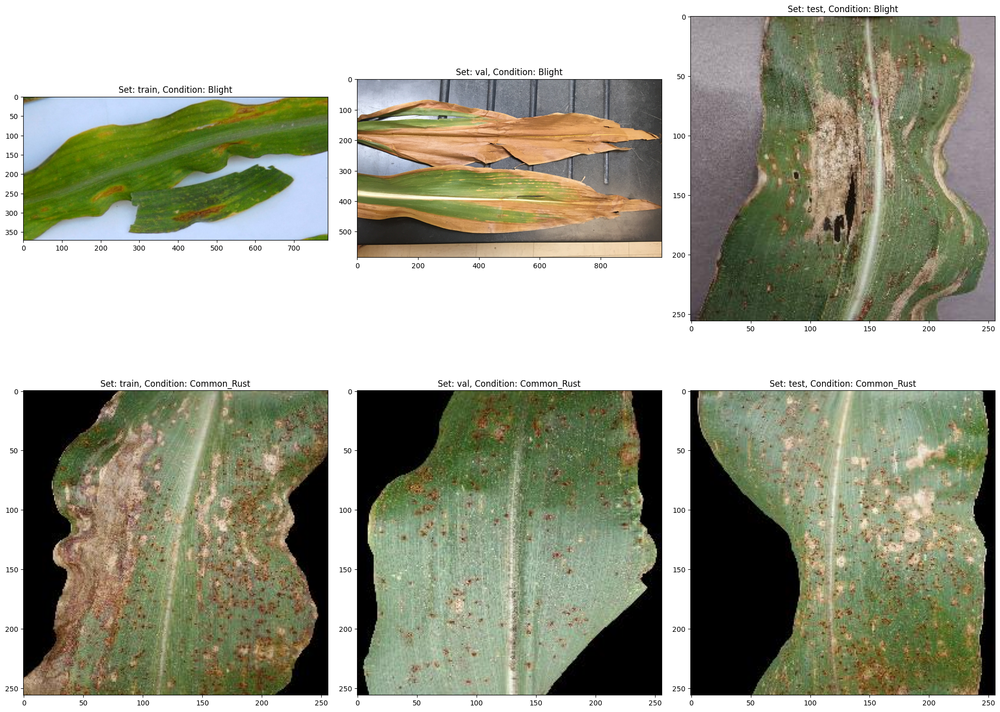

In [16]:
##
# This code visualizes sample images from two conditions (Blight and Common Rust) for each dataset split (train, val, and test)
path_ = data_dir+'/'

fig, ax = plt.subplots(2,3,figsize=(20,15))
ax = ax.ravel()
plt.tight_layout()
# Set up the plotting environment:
for i, set_ in enumerate(['train','val', 'test']):
    set_path = path_+ set_
    # Display images for the "Blight" condition:
    ax[i].imshow(plt.imread(set_path+'/Blight/'+os.listdir(set_path+'/Blight')[0]))
    ax[i].set_title('Set: {}, Condition: Blight'.format(set_))
    # Display images for the "Common Rust" condition:
    ax[i+3].imshow(plt.imread(set_path+'/Common_Rust/'+os.listdir(set_path+'/Common_Rust')[0]))
    ax[i+3].set_title('Set: {}, Condition: Common_Rust'.format(set_))

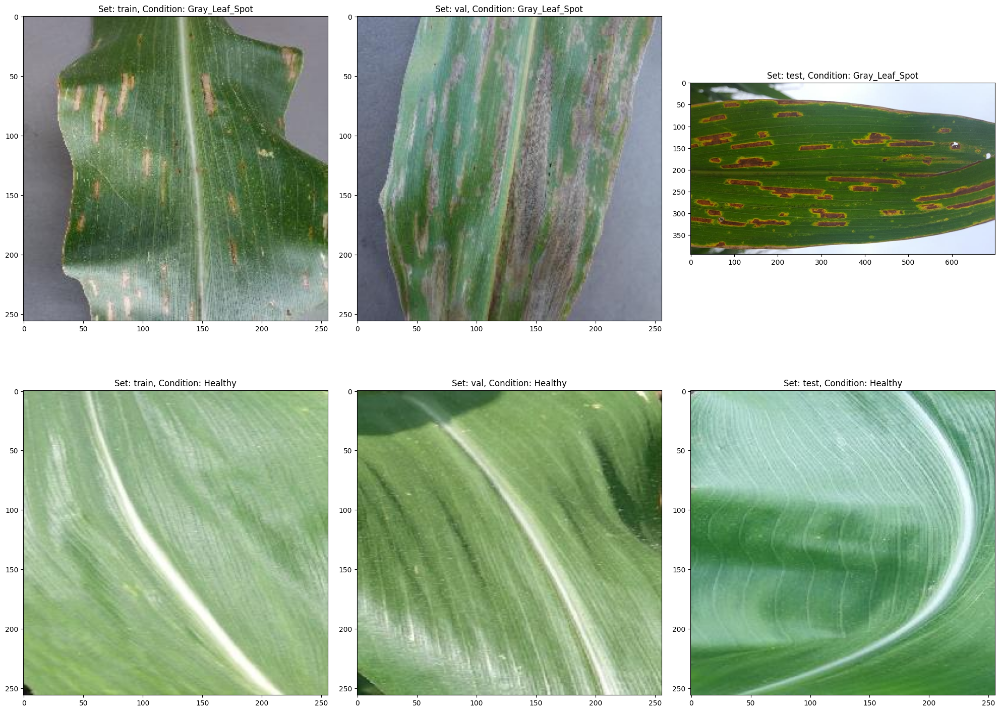

In [17]:
fig, ax = plt.subplots(2,3,figsize=(20,15))
ax = ax.ravel()
plt.tight_layout()

for i, set_ in enumerate(['train','val','test']):
    set_path = path_+ set_
    # Display images for the Gray_Leaf_Spot condition:
    ax[i].imshow(plt.imread(set_path+'/Gray_Leaf_Spot/'+os.listdir(set_path+'/Gray_Leaf_Spot')[0]))
    ax[i].set_title('Set: {}, Condition: Gray_Leaf_Spot'.format(set_))
    # Display images for the Healthy condition:
    ax[i+3].imshow(plt.imread(set_path+'/Healthy/'+os.listdir(set_path+'/Healthy')[0]))
    ax[i+3].set_title('Set: {}, Condition: Healthy'.format(set_))

In [18]:

# to create training and validation data generators for image data preprocessing.
def train_val_test_data(img_dims, batch_size):

  ## Training data generator with augmentationa
  train_datagen = ImageDataGenerator(rescale = 1./255,
                                       rotation_range = 40, # Randomly rotate images by up to 40 degrees.
                                       width_shift_range = .2,
                                       height_shift_range = .2,
                                       shear_range = .2,# Apply random shearing transformations.
                                       zoom_range = 0.3,
                                       horizontal_flip = True,
                                       vertical_flip=True,
                                       brightness_range=[0.5, 1.5], # Randomly adjust brightness within the specified range.
                                       featurewise_center=True,
                                       featurewise_std_normalization=True, # Normalize images based on dataset standard deviation.
                                       fill_mode = 'nearest', # Fill missing pixels after transformations with the nearest pixel value.
                                   )


  ## Train generator
  train_gen = train_datagen.flow_from_directory(directory = path_ + 'train',
                                                  target_size = (img_dims, img_dims),  # Resize all images to the specified dimensions.
                                                  batch_size = batch_size,  # Number of images per batch.
                                                  class_mode = 'categorical', # Multi-class classification mode; one-hot encodes labels.
                                                  shuffle = True) # Shuffle the data to enhance randomness during training.

  ## Validation Data minimal preprocessing, no augmentation)
  validation_datagen = ImageDataGenerator(rescale = 1./255)

  ## validation generator
  val_gen = validation_datagen.flow_from_directory(directory = path_ + 'val',
                                                      target_size = (img_dims, img_dims),
                                                      batch_size = batch_size,
                                                      class_mode = 'categorical',
                                                      shuffle = True)



  return train_gen, val_gen

In [19]:
# Set the dimensions for resizing images and the batch size for data generators
img_dims = 224  # The dimensions (224x224) to which all images will be resized.
batch_size = 128 # Number of images in each batch for training and validation.

# Call the train_val_test_data function to create data generators
train_gen, val_gen = train_val_test_data(img_dims, batch_size)

Found 2985 images belonging to 4 classes.
Found 836 images belonging to 4 classes.


## **Modeling**

- Transfer learning (MobileNetV2 architecture)
- Fine-tuning


In [20]:
## Choose a device type (CPU or GPU)
# devices = tf.config.list_physical_devices('GPU')
# print(devices[0])

# ## Name divice
# name_gpu = "GPU:0"

# ## Define my strategy like One Device Strategy
# strategy = tf.distribute.OneDeviceStrategy(device=name_gpu)



# List all physical devices of type 'GPU' available in the system
devices = tf.config.list_physical_devices('GPU')
if devices:
    print("GPU available:", devices[0])
    name_gpu = "GPU:0"
    # Create a distribution strategy for running computations on the GPU
    strategy = tf.distribute.OneDeviceStrategy(device=name_gpu)
else:
    print("No GPU found. Using CPU instead.")
    strategy = tf.distribute.OneDeviceStrategy(device="CPU")

No GPU found. Using CPU instead.


In [21]:
def mobilenetv2():
# Load the pre-trained MobileNetV2 model
  mobilenet_m = tf.keras.applications.mobilenet_v2.MobileNetV2(input_shape=(
        img_dims,img_dims,3),
        include_top = False, # Exclude the fully connected layers at the top
        weights = 'imagenet' # Load pre-trained weights from ImageNet
      )
  x = mobilenet_m.trainable = False # Ensures the pre-trained layers are not updated during training

  # Get the output of the MobileNetV2 base model
  x = mobilenet_m.output

# Add a global average pooling layer to reduce the spatial dimensions
  x = GlobalAveragePooling2D()(x)

  # Add a fully connected output layer with softmax activation for multi-class classification
  out = Dense(4,activation='softmax')(x)

 # Create the final model by specifying inputs and outputs
  model = Model(inputs = mobilenet_m.inputs, outputs = out)

  # Print the model architecture summary for verification
  model.summary()

  return model

In [22]:
# Use the distribution strategy scope for efficient computation on the specified device (GPU/CPU)

with strategy.scope():
  # Create the MobileNetV2 model using the defined function
  mobilenetv2_model = mobilenetv2()
  # Compile the model
  mobilenetv2_model.compile(loss = 'categorical_crossentropy', optimizer = Adam(learning_rate = .0001),metrics = ['accuracy'])

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1 (Conv2D)            │ (None, 112, 112, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bn_Conv1                  │ (None, 112, 112, 32)   │            128 │ Conv1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1_relu (ReLU)         │ (None, 112, 112, 32)   │              0 │ bn_Conv1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise   │ (None, 112, 112, 32)   │            288 │ Conv1_relu[0][0]       │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │            128 │ expanded_conv_depthwi… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │              0 │ expanded_conv_depthwi… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project     │ (None, 112, 112, 16)   │            512 │ expanded_conv_depthwi… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project_BN  │ (None, 112, 112, 16)   │             64 │ expanded_conv_project… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand (Conv2D)   │ (None, 112, 112, 96)   │          1,536 │ expanded_conv_project… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_BN         │ (None, 112, 112, 96)   │            384 │ block_1_expand[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_relu       │ (None, 112, 112, 96)   │              0 │ block_1_expand_BN[0][… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_pad               │ (None, 113, 113, 96)   │              0 │ block_1_expand_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise         │ (None, 56, 56, 96)     │            864 │ block_1_pad[0][0]      │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise_BN 

 Total params: 2,263,108 (8.63 MB)

 Trainable params: 5,124 (20.02 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [23]:
epochs_1 = 25

### **Train the MobileNetV2 model**

In [24]:

# history_1 = mobilenetv2_model.fit(train_gen, steps_per_epoch=train_gen.samples // batch_size,
#                                epochs=epochs_1, validation_data=(val_gen),
#                                validation_steps=val_gen.samples // batch_size
#
from math import ceil # Import the ceil function to round up numbers to the nearest integer

# Calculate the number of steps per epoch for training
steps_per_epoch = ceil(train_gen.samples / batch_size)
validation_steps = ceil(val_gen.samples / batch_size)
# `val_gen.samples`: Total number of validation samples in the dataset
# The same logic as `steps_per_epoch` applies here to cover all validation samples.

# Train the model using the training and validation data generators
history_1 = mobilenetv2_model.fit(
    train_gen,
    steps_per_epoch=steps_per_epoch,  # Number of batches to process per epoch
    epochs=epochs_1,
    validation_data=val_gen,
    validation_steps=validation_steps # Number of validation batches to process per epoch
)


Epoch 1/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 1521s 63s/step - accuracy: 0.1968 - loss: 1.7801 - val_accuracy: 0.3404 - val_loss: 1.4780
Epoch 2/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 290s 11s/step - accuracy: 0.3526 - loss: 1.4204 - val_accuracy: 0.4859 - val_loss: 1.1848
Epoch 3/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 60s 3s/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.4788 - val_loss: 1.1937
Epoch 4/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 264s 10s/step - accuracy: 0.5201 - loss: 1.1379 - val_accuracy: 0.5989 - val_loss: 1.0114
Epoch 5/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 82s 3s/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5989 - val_loss: 1.0073
Epoch 6/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 252s 10s/step - accuracy: 0.6144 - loss: 1.0007 - val_accuracy: 0.6794 - val_loss: 0.8705
Epoch 7/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 82s 3s/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6751 - val_loss: 0.8845
Epoch 8/25
24/24 ━━━━━━━━━━━━━━━━━━━━ 253s 9s/step - accuracy: 0.6963 - loss: 0.8529 

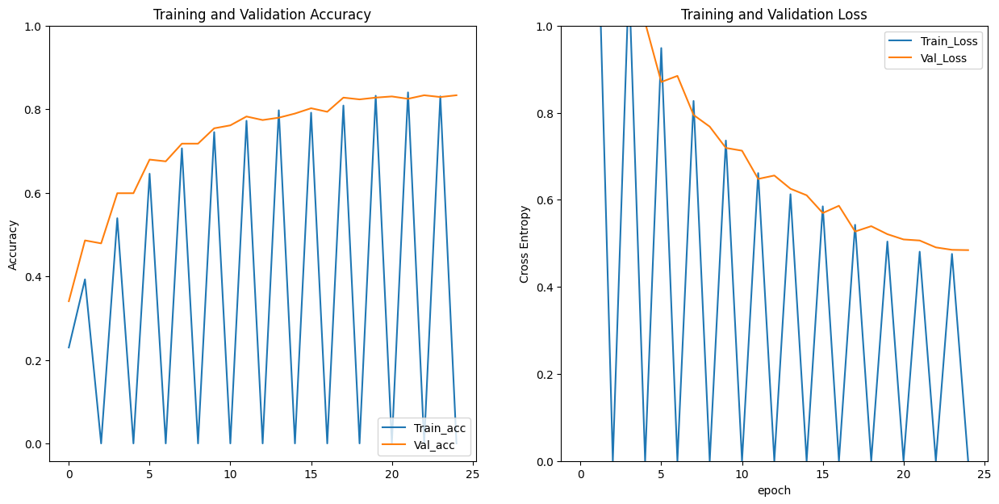

In [25]:
### Loss and accuracy plot

# Extract accuracy values from the training history
acc_mob = history_1.history['accuracy']
val_acc_mob = history_1.history['val_accuracy']


# Extract loss values from the training history
loss_mob = history_1.history['loss']
val_loss_mob = history_1.history['val_loss']

# Plot training and validation accuracy
plt.figure(figsize=(15, 7))
plt.subplot(1, 2, 1)
plt.plot(acc_mob, label='Train_acc')
plt.plot(val_acc_mob, label='Val_acc')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

# Plot training and validation loss
plt.subplot(1, 2, 2)
plt.plot(loss_mob, label='Train_Loss')
plt.plot(val_loss_mob, label='Val_Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [26]:
result_eval = mobilenetv2_model.evaluate(val_gen, verbose =0)

for metric, eval in zip(mobilenetv2_model.metrics_names, result_eval):
  print(metric + ': {:.3}'.format(eval))

loss: 0.474
compile_metrics: 0.834


7/7 ━━━━━━━━━━━━━━━━━━━━ 49s 6s/step


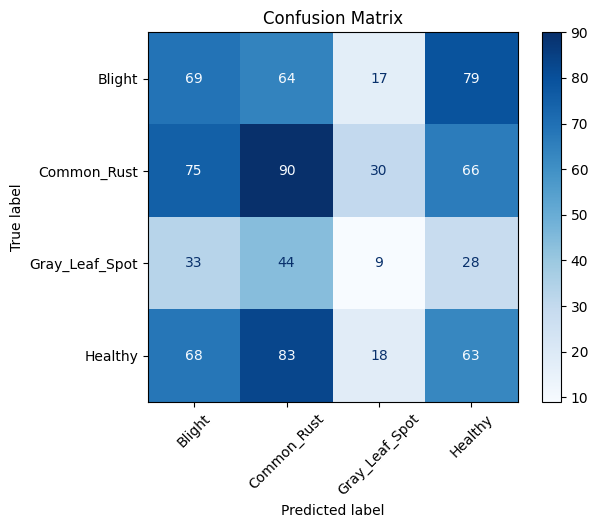

In [27]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np

# Generate predictions on the validation set
val_predictions = mobilenetv2_model.predict(val_gen)
val_pred_classes = np.argmax(val_predictions, axis=1)  # Get the predicted class indices
val_true_classes = val_gen.classes  # Get the true class indices

# Compute the confusion matrix
cm = confusion_matrix(val_true_classes, val_pred_classes)

# Define the class labels (update with your actual class names)
class_labels = list(val_gen.class_indices.keys())

# Plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap='Blues', xticks_rotation=45)
plt.title('Confusion Matrix')
plt.show()


In [28]:
from sklearn.metrics import classification_report

# Generate predictions on the validation set
val_predictions = mobilenetv2_model.predict(val_gen)
val_pred_classes = np.argmax(val_predictions, axis=1)  # Get the predicted class indices
val_true_classes = val_gen.classes  # Get the true class indices

# Define the class labels (update with your actual class names)
class_labels = list(val_gen.class_indices.keys())

# Generate the classification report
report = classification_report(val_true_classes, val_pred_classes, target_names=class_labels)

# Print the classification report
print("Classification Report:\n")
print(report)


7/7 ━━━━━━━━━━━━━━━━━━━━ 46s 6s/step
Classification Report:

                precision    recall  f1-score   support

        Blight       0.33      0.36      0.35       229
   Common_Rust       0.30      0.33      0.31       261
Gray_Leaf_Spot       0.11      0.07      0.09       114
       Healthy       0.26      0.27      0.26       232

      accuracy                           0.28       836
     macro avg       0.25      0.26      0.25       836
  weighted avg       0.27      0.28      0.28       836



In [29]:
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score

# Generate predictions on the validation set
val_predictions = mobilenetv2_model.predict(val_gen)
val_pred_classes = np.argmax(val_predictions, axis=1)  # Get the predicted class indices
val_true_classes = val_gen.classes  # Get the true class indices

# Compute and print overall metrics
accuracy = accuracy_score(val_true_classes, val_pred_classes)
precision = precision_score(val_true_classes, val_pred_classes, average='weighted')  # Weighted average for precision
recall = recall_score(val_true_classes, val_pred_classes, average='weighted')  # Weighted average for recall
f1 = f1_score(val_true_classes, val_pred_classes, average='weighted')  # Weighted average for F1-score

print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1-Score: {f1:.2f}")

# Generate the classification report for detailed metrics per class
class_labels = list(val_gen.class_indices.keys())  # Class labels
report = classification_report(val_true_classes, val_pred_classes, target_names=class_labels)
print("\nClassification Report:\n")
print(report)


7/7 ━━━━━━━━━━━━━━━━━━━━ 47s 6s/step
Accuracy: 0.29
Precision: 0.28
Recall: 0.29
F1-Score: 0.28

Classification Report:

                precision    recall  f1-score   support

        Blight       0.30      0.32      0.31       229
   Common_Rust       0.33      0.36      0.34       261
Gray_Leaf_Spot       0.16      0.11      0.13       114
       Healthy       0.27      0.28      0.27       232

      accuracy                           0.29       836
     macro avg       0.27      0.26      0.26       836
  weighted avg       0.28      0.29      0.28       836



### **Fine-tuning the model**
- Un-freeze the top layers of MobileNetV2 model
- training:
  - Total epochs = 75
  - Adam optimazer with a low learning rate (base_learning_rate/10) to avoid the overfitting

In [30]:
## Unfreezing layers
mobilenetv2_model.trainable = True

In [31]:
## Fine-tuning
## number of layer in the pre-trained model
print('Number of layer in the pre-trained model:{}'.format(len(mobilenetv2_model.layers)))
fine_tune_at = 100

for layer in mobilenetv2_model.layers[:fine_tune_at]:
  layer.trainable = False
print(f"Trainable Layers: {len(mobilenetv2_model.trainable_variables)}")

Number of layer in the pre-trained model:156
Trainable Layers: 2


In [32]:
with strategy.scope():

  mobilenetv2_model.summary()
  mobilenetv2_model.compile(loss = 'categorical_crossentropy', optimizer = Adam(learning_rate = 0.0001/10),metrics = ['accuracy'])

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1 (Conv2D)            │ (None, 112, 112, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bn_Conv1                  │ (None, 112, 112, 32)   │            128 │ Conv1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1_relu (ReLU)         │ (None, 112, 112, 32)   │              0 │ bn_Conv1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise   │ (None, 112, 112, 32)   │            288 │ Conv1_relu[0][0]       │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │            128 │ expanded_conv_depthwi… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │              0 │ expanded_conv_depthwi… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project     │ (None, 112, 112, 16)   │            512 │ expanded_conv_depthwi… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project_BN  │ (None, 112, 112, 16)   │             64 │ expanded_conv_project… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand (Conv2D)   │ (None, 112, 112, 96)   │          1,536 │ expanded_conv_project… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_BN         │ (None, 112, 112, 96)   │            384 │ block_1_expand[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_relu       │ (None, 112, 112, 96)   │              0 │ block_1_expand_BN[0][… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_pad               │ (None, 113, 113, 96)   │              0 │ block_1_expand_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise         │ (None, 56, 56, 96)     │            864 │ block_1_pad[0][0]      │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise_BN 

 Total params: 2,273,358 (8.67 MB)

 Trainable params: 5,124 (20.02 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

 Optimizer params: 10,250 (40.04 KB)

In [33]:
## Training
# fine_tune_epochs = 25
# total_epochs = epochs_1 + fine_tune_epochs

# history_fine = mobilenetv2_model.fit(train_gen, steps_per_epoch=train_gen.samples // batch_size,
#                                             epochs=total_epochs,
#                                             initial_epoch = history_1.epoch[-1],
#                                             validation_data=(val_gen),
#                                             validation_steps=val_gen.samples // batch_size,
#                                     )


from math import ceil

# Calculate the correct steps per epoch and validation steps
steps_per_epoch = ceil(train_gen.samples / batch_size)
validation_steps = ceil(val_gen.samples / batch_size)

# Perform fine-tuning
fine_tune_epochs = 25
total_epochs = len(history_1.epoch) + fine_tune_epochs  # len(history_1.epoch) = 50

history_fine = mobilenetv2_model.fit(
    train_gen,
    steps_per_epoch=steps_per_epoch,
    epochs=total_epochs,
    initial_epoch=len(history_1.epoch),  # Start fine-tuning after the initial training
    validation_data=val_gen,
    validation_steps=validation_steps,
)


Epoch 26/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 235s 10s/step - accuracy: 0.8466 - loss: 0.4572 - val_accuracy: 0.8333 - val_loss: 0.4688
Epoch 27/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 255s 10s/step - accuracy: 0.8281 - loss: 0.4721 - val_accuracy: 0.8319 - val_loss: 0.4636
Epoch 28/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8347 - val_loss: 0.4664
Epoch 29/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 261s 10s/step - accuracy: 0.8475 - loss: 0.4533 - val_accuracy: 0.8347 - val_loss: 0.4531
Epoch 30/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8277 - val_loss: 0.4609
Epoch 31/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 273s 10s/step - accuracy: 0.8432 - loss: 0.4399 - val_accuracy: 0.8291 - val_loss: 0.4690
Epoch 32/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 82s 3s/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8333 - val_loss: 0.4597
Epoch 33/50
24/24 ━━━━━━━━━━━━━━━━━━━━ 260s 10s/step - accuracy: 0.8435 - loss:

In [ ]:
# print(history_1.epoch)

#### **Fine-tuning model performance**
- loss and accuracy plot
- Evaluate with the validation set
- Metrics:
 - Accuracy


In [34]:
acc_mob += history_fine.history['accuracy']
val_acc_mob += history_fine.history['val_accuracy']

loss_mob += history_fine.history['loss']
val_loss_mob += history_fine.history['val_loss']


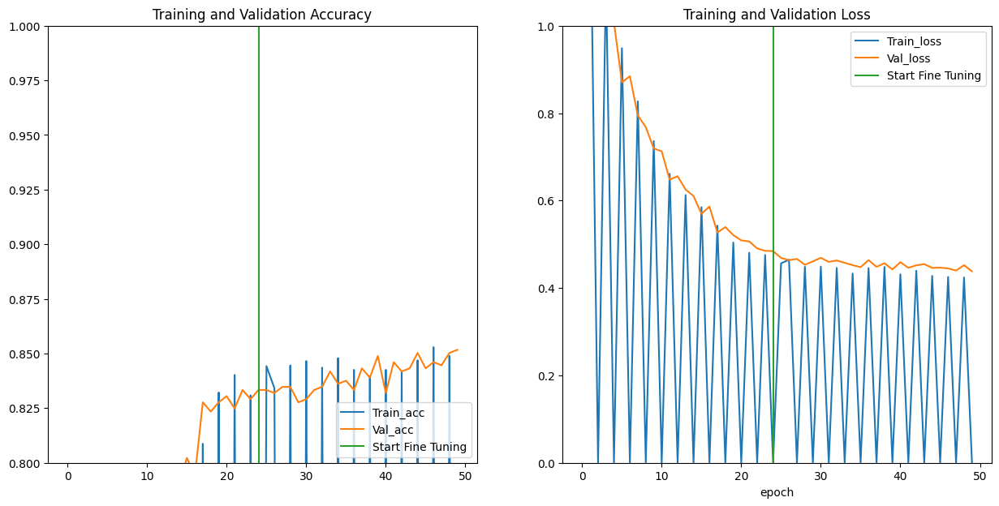

In [35]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 2, 1)
plt.plot(acc_mob, label='Train_acc')
plt.plot(val_acc_mob, label='Val_acc')
plt.ylim([0.8, 1])
plt.plot([epochs_1-1,epochs_1-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(loss_mob, label='Train_loss')
plt.plot(val_loss_mob, label='Val_loss')
plt.ylim([0, 1.0])
plt.plot([epochs_1-1,epochs_1-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [36]:
result_eval_f = mobilenetv2_model.evaluate(val_gen, verbose =0)

for metric_, eval_ in zip(mobilenetv2_model.metrics_names, result_eval_f):
  print(metric_ + ': {:.3}'.format(eval_))

loss: 0.438
compile_metrics: 0.849


7/7 ━━━━━━━━━━━━━━━━━━━━ 49s 6s/step


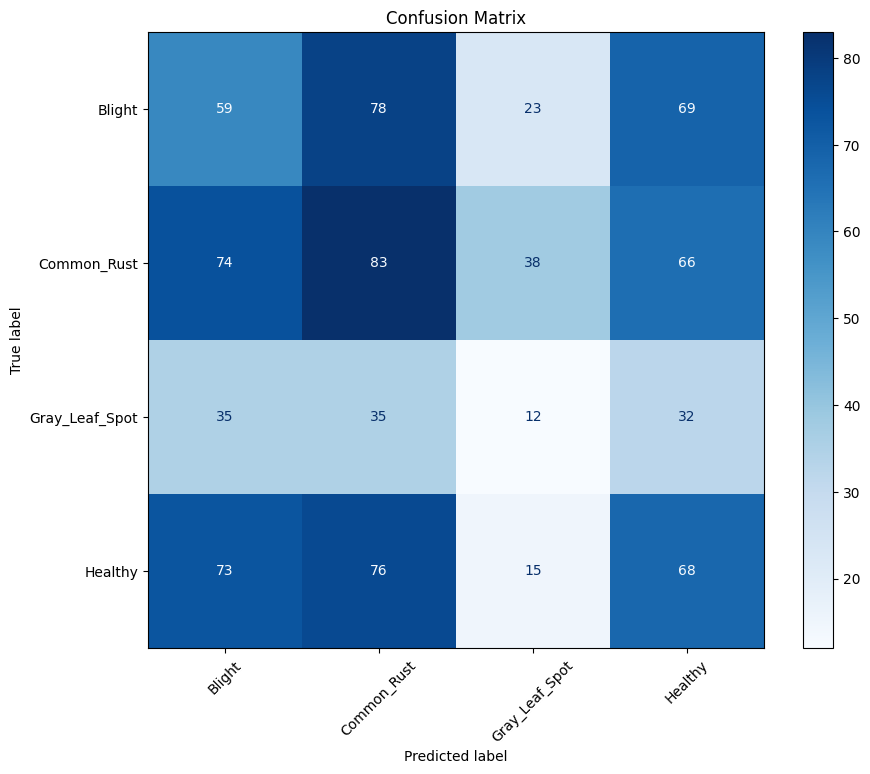

##### **Observations**

- The initial model with the transfer learning technique reaches a good performance(accuracy = 0.87).

- Unfreezing some layers (fine-tuning) give more performance to the model, reaching an accuracy = 0.92 and loss = 0.21 with the validation set

### **Model Evaluation with the test set**

In [38]:
## Import the test set
input_test = '/content/drive/MyDrive/splitted_data/test'
labels = os.listdir(input_test)
# def get_data(data_dir):
#     data = []
#     for label in labels:
#         path = os.path.join(data_dir, label)
#         class_num = labels.index(label)
#         for img in os.listdir(path):
#             try:
#                 img_arr = cv2.imread(os.path.join(path, img))[...,::-1] #convert BGR to RGB format
#                 resized_arr = cv2.resize(img_arr, (img_dims, img_dims)) # Reshaping images to preferred size
#                 data.append([resized_arr, class_num])
#             except Exception as e:
#                 print(e)
#     return np.array(data)

def get_data(data_dir):
    data = []
    for label in labels:
        path = os.path.join(data_dir, label)
        class_num = labels.index(label)
        for img in os.listdir(path):
            try:
                # Read image and convert BGR to RGB
                img_arr = cv2.imread(os.path.join(path, img))[..., ::-1]
                if img_arr is None:
                    print(f"Warning: Unable to read image {os.path.join(path, img)}")
                    continue
                # Resize image
                resized_arr = cv2.resize(img_arr, (img_dims, img_dims))
                # Append image and label
                data.append([resized_arr, class_num])
            except Exception as e:
                print(f"Error processing file {os.path.join(path, img)}: {e}")
    return data  # Keep as list to avoid NumPy conversion issues

# Reload test data
test_set_ = get_data(input_test)

# Extract features and labels
X_test, y_test = zip(*test_set_)
X_test = np.array(X_test) / 255.0  # Normalize pixel values
y_test = np.array(y_test)


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/Plant_Village_Dataset_Corn/Leaf_Disease/test'

In [ ]:
# test_set_ = get_data(input_test)

# ## X and y test
# X_test, y_test = [],[]
# for feature, labels in test_set_:
#   X_test.append(feature)
#   y_test.append(labels)
# ## Convert the data in arrays
# X_test = np.array(X_test) / 255
# y_test = np.array(y_test)

In [ ]:
## Prediction
y_pred = np.argmax(mobilenetv2_model.predict(X_test), axis = -1)

14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 268ms/step


In [ ]:
from sklearn.metrics import accuracy_score

#print("CONFUSION MATRIX ------------------------------")
fig, ax = plt.subplots(figsize=(9,9))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred, cmap = 'Blues', ax = ax)
ax.set_xlabel("Actual values")
ax.set_ylabel("Predicted Values")
ax.xaxis.set_ticklabels(["Blight", "Common_Rust","Gray_Leaf_Spot", "Healthy"])
ax.yaxis.set_ticklabels(["Blight", "Common_Rust","Gray_Leaf_Spot", "Healthy"])

## Accuracy and F1-Score
acc_x = accuracy_score(y_test, y_pred)

print(f'Accuracy: {round(acc_x, 3)}%')

In [ ]:
from sklearn.metrics import classification_report

# Generate the classification report
report = classification_report(
    y_test,  # True labels
    y_pred,  # Predicted labels
    target_names=["Blight", "Common_Rust", "Gray_Leaf_Spot", "Healthy"]  # Class names
)

# Print the classification report
print("Classification Report:\n")
print(report)


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report

# Calculate individual metrics
accuracy = accuracy_score(y_test, y_pred)  # Overall accuracy
precision = precision_score(y_test, y_pred, average='weighted')  # Weighted average precision
recall = recall_score(y_test, y_pred, average='weighted')  # Weighted average recall
f1 = f1_score(y_test, y_pred, average='weighted')  # Weighted average F1-score

# Print individual metrics
print("Model Evaluation Metrics:")
print(f"Accuracy: {accuracy:.3f}")
print(f"Precision: {precision:.3f}")
print(f"Recall: {recall:.3f}")
print(f"F1-Score: {f1:.3f}")

# Generate and print the classification report
class_labels = ["Blight", "Common_Rust", "Gray_Leaf_Spot", "Healthy"]  # Replace with actual class names
report = classification_report(y_test, y_pred, target_names=class_labels)
print("\nClassification Report:\n")
print(report)


### **Final Observations**

- In general, the model reaches quite good performance with the test set, achieving an Accuracy of 94% .

- By analysing the Confusion Matrix, we can see that the model is so good at identifying Healthy leaf images (116 out of 116) and Common Rust leaf image ( 127 out of 129) with 100% and 98.44%  images correctly classified repeclty. On the other hand, the model with respect the other classes reached a performance aceptable, with 92.3% images correctly classified for Blight leaf  and 84.6% for Grey leaf spot.

### **Save the MobileNet model**

In [ ]:
# ## Save model in HDF5 format
# export_path = '/content/drive/MyDrive/Plant_Village_Dataset_Corn/save_model/model_mobnetv2'
# mobilenetv2_model.save(export_path)#export_path

In [ ]:
export_path = '/content/drive/MyDrive/Plant_Village_Dataset_Corn/save_model/model_mobnetv2.h5'
mobilenetv2_model.save(export_path)


In [ ]:
export_path = '/content/drive/MyDrive/Plant_Village_Dataset_Corn/save_model/Mymodel_mobnetv2.keras'
mobilenetv2_model.save(export_path)


In [ ]:
!pip install tf-keras-vis matplotlib



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 2.6 MB/s eta 0:00:00


In [ ]:
from tensorflow.keras.models import load_model
# Provide the path to the saved model
model_path = 'SavedModels/Mymodel_mobnetv2.keras'
mobilenetv2_model = load_model(model_path)

print("Model loaded successfully!")


Model loaded successfully!


In [ ]:
mobilenetv2_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,268,234 (8.65 MB)

 Trainable params: 5,124 (20.02 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

 Optimizer params: 5,126 (20.03 KB)

In [ ]:
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import numpy as np

# Load and preprocess a single image
img_path = 'dataset/Gray_Leaf_Spot/Corn_Gray_Spot (11).jpg'
img = load_img(img_path, target_size=(224, 224))  # Resize to input size
img_array = img_to_array(img) / 255.0  # Normalize
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension



predictions = mobilenetv2_model.predict(img_array)
predicted_class = np.argmax(predictions, axis=1)  # Get the class with highest probability
print(f"Predicted class: {predicted_class}")




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predicted class: [2]


In [ ]:

from tensorflow.keras.preprocessing.image import ImageDataGenerator

def create_test_data(img_dims, batch_size, test_path):
    """
    Creates a test data generator for evaluating the model.

    Args:
        img_dims (int): Dimensions to resize images to (img_dims x img_dims).
        batch_size (int): Number of images per batch.
        test_path (str): Path to the test dataset directory.

    Returns:
        test_gen: A generator for the test dataset.
    """
    test_datagen = ImageDataGenerator(rescale=1./255)

    # Test generator
    test_gen = test_datagen.flow_from_directory(
        directory=test_path,
        target_size=(img_dims, img_dims),
        batch_size=batch_size,
        class_mode='categorical',
        shuffle=False  # Do not shuffle for test data
    )
    return test_gen

# Define path to the test dataset
test_path =  path_+'test'  # Ensure 'test/' exists within your dataset structure

# Create test generator
test_gen = create_test_data(img_dims, batch_size, test_path)

# Verify test generator
print(f"Test samples: {test_gen.samples}")

test_loss, test_accuracy = mobilenetv2_model.evaluate(test_gen)
print(f"Test Loss: {test_loss}, Test Accuracy: {test_accuracy}")


# Fetch a batch of images and labels from the test generator
image_batch, label_batch = next(test_gen)

print(f"Image batch shape: {image_batch.shape}")
print(f"Label batch shape: {label_batch.shape}")






Found 803 images belonging to 4 classes.
Test samples: 803
7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 672ms/step - accuracy: 0.8820 - loss: 0.3156
Test Loss: 0.2762240767478943, Test Accuracy: 0.8966376185417175
Image batch shape: (128, 224, 224, 3)
Label batch shape: (128, 4)


# LIME Implementation with MobileNet v2

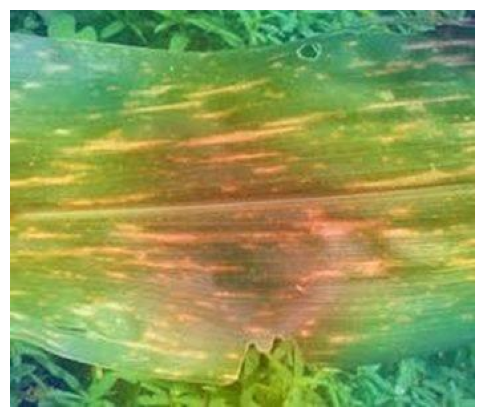

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras.models import load_model
from matplotlib import cm

# Grad-CAM++ Function
def make_gradcamplus_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        model.inputs,
        [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        # Forward pass to get the feature maps and predictions
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # Compute first, second, and third order gradients
    grads = tape.gradient(class_channel, last_conv_layer_output)  # First-order gradients
    grads_squared = tf.square(grads)                              # Second-order gradients
    grads_cubed = grads * grads_squared                           # Third-order gradients

    # Pool gradients
    alpha_num = grads_squared  # Numerator of alphas
    alpha_denom = 2 * grads_squared + last_conv_layer_output * grads_cubed + 1e-8  # Denominator of alphas
    alphas = alpha_num / alpha_denom  # Alpha values

    # Compute weights
    weights = tf.reduce_sum(alphas * tf.maximum(grads, 0), axis=(0, 1, 2))

    # Compute the Grad-CAM++ heatmap
    last_conv_layer_output = last_conv_layer_output[0]  # Shape: (H, W, N)
    heatmap = np.dot(last_conv_layer_output, weights)

    # ReLU to retain only positive influences, then normalize
    heatmap = np.maximum(heatmap, 0)
    heatmap = heatmap / np.max(heatmap) if np.max(heatmap) != 0 else heatmap

    return heatmap

# Helper function to load image and preprocess
def get_img_array(img_path, size):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(size, size))
    array = tf.keras.preprocessing.image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = array / 255.0
    return array

# Helper function to save and display Grad-CAM++
def save_and_display_gradcam(img_path, heatmap, cam_path="cam.jpg", alpha=0.4):
    img = tf.keras.preprocessing.image.load_img(img_path)
    img = tf.keras.preprocessing.image.img_to_array(img)

    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    return cam_path

# Load the MobileNetV2 model


# Set parameters
img_size = 224
img_path =  img_path # Update with the image path
last_conv_layer_name = 'Conv_1'  # Last convolutional layer in MobileNetV2

# Preprocess image
img_array = get_img_array(img_path, size=img_size)

# Generate Grad-CAM++ heatmap
heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

# Display the result
cam_path = save_and_display_gradcam(img_path, heatmap)
plt.figure(figsize=(6, 6))
plt.imshow(plt.imread(cam_path))
plt.axis('off')
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


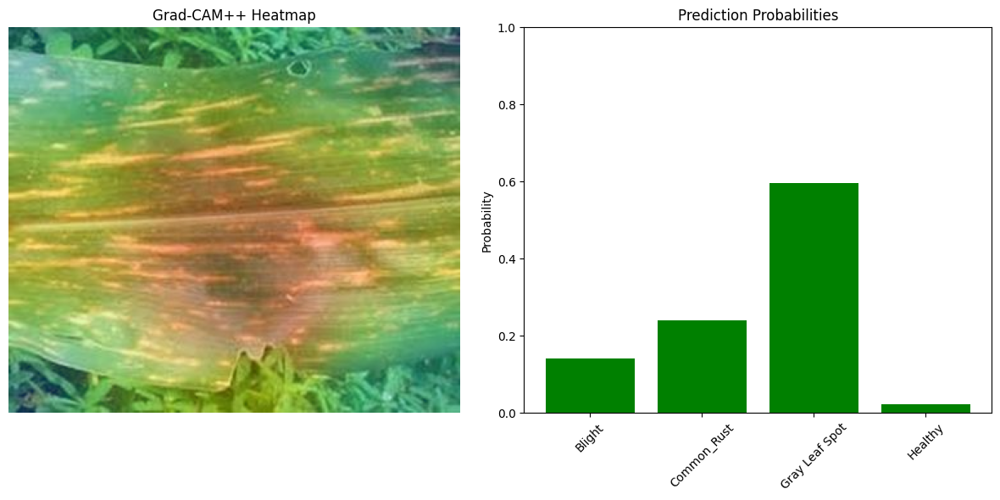

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_gradcam_with_probabilities(img_path, heatmap, probabilities, class_names, alpha=0.4):
    """
    Display Grad-CAM++ heatmap alongside a bar plot of class probabilities.

    Parameters:
        img_path (str): Path to the input image.
        heatmap (numpy array): Grad-CAM++ heatmap.
        probabilities (list or numpy array): Probabilities for all classes.
        class_names (list): Names of the classes.
        alpha (float): Transparency for heatmap overlay.
    """
    # Load and preprocess the image
    img = tf.keras.preprocessing.image.load_img(img_path)
    img = tf.keras.preprocessing.image.img_to_array(img)

    # Apply the heatmap to the image
    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Create the plots
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))

    # Grad-CAM++ heatmap
    ax[0].imshow(superimposed_img)
    ax[0].axis('off')
    ax[0].set_title('Grad-CAM++ Heatmap')

    # Bar plot for probabilities
    ax[1].bar(range(len(probabilities)), probabilities, color='green')
    ax[1].set_xticks(range(len(class_names)))
    ax[1].set_xticklabels(class_names, rotation=45)
    ax[1].set_ylim(0, 1)
    ax[1].set_ylabel('Probability')
    ax[1].set_title('Prediction Probabilities')

    plt.tight_layout()
    plt.show()

# Example usage
img_path = img_path  # Update this path
class_names = ['Blight', 'Common_Rust', 'Gray Leaf Spot', 'Healthy']  # Update based on your classes
predictions = model.predict(img_array)  # Predict with your model
predicted_class_probs = predictions[0]  # Assuming batch size of 1
predicted_class_index = np.argmax(predicted_class_probs)

# Generate Grad-CAM++ heatmap
heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

# Plot the visualization
plot_gradcam_with_probabilities(img_path, heatmap, predicted_class_probs, class_names)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


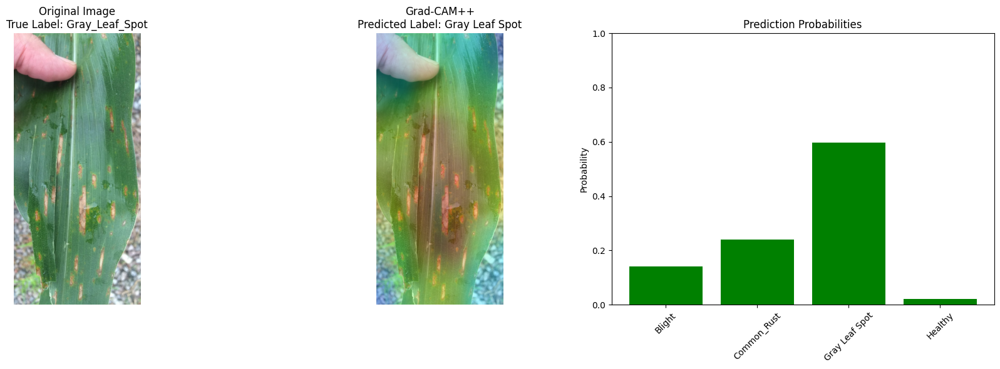

In [ ]:
def plot_full_visualization(img_path, heatmap, probabilities, class_names, true_label, predicted_label, alpha=0.4):
    """
    Display the original image with the true label, Grad-CAM++ heatmap with the predicted label,
    and a bar plot for class probabilities.

    Parameters:
        img_path (str): Path to the input image.
        heatmap (numpy array): Grad-CAM++ heatmap.
        probabilities (list or numpy array): Probabilities for all classes.
        class_names (list): Names of the classes.
        true_label (str): True label of the image.
        predicted_label (str): Predicted label of the image.
        alpha (float): Transparency for heatmap overlay.
    """
    # Load the original image
    img = tf.keras.preprocessing.image.load_img(img_path)
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    # Apply the heatmap to the image
    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img_array.shape[1], img_array.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img_array
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Create the plots
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))

    # Original image with true label
    ax[0].imshow(img)
    ax[0].axis('off')
    ax[0].set_title(f"Original Image\nTrue Label: {true_label}")

    # Grad-CAM++ heatmap with predicted label
    ax[1].imshow(superimposed_img)
    ax[1].axis('off')
    ax[1].set_title(f"Grad-CAM++\nPredicted Label: {predicted_label}")

    # Bar plot for probabilities
    ax[2].bar(range(len(probabilities)), probabilities, color='green')
    ax[2].set_xticks(range(len(class_names)))
    ax[2].set_xticklabels(class_names, rotation=45)
    ax[2].set_ylim(0, 1)
    ax[2].set_ylabel('Probability')
    ax[2].set_title('Prediction Probabilities')

    plt.tight_layout()
    plt.show()

# Example usage
img_path = 'dataset/Gray_Leaf_Spot/Corn_Gray_Spot (10).jpg'  # Path to your test image
class_names = ['Blight', 'Common_Rust', 'Gray Leaf Spot', 'Healthy']  # Update class names
true_label = 'Gray_Leaf_Spot'  # True label of the test image (update accordingly)

# Predict probabilities and class
predictions = model.predict(img_array)  # Predict with your model
predicted_class_probs = predictions[0]
predicted_class_index = np.argmax(predicted_class_probs)
predicted_label = class_names[predicted_class_index]

# Generate Grad-CAM++ heatmap
heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

# Plot the visualization
plot_full_visualization(img_path, heatmap, predicted_class_probs, class_names, true_label, predicted_label)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


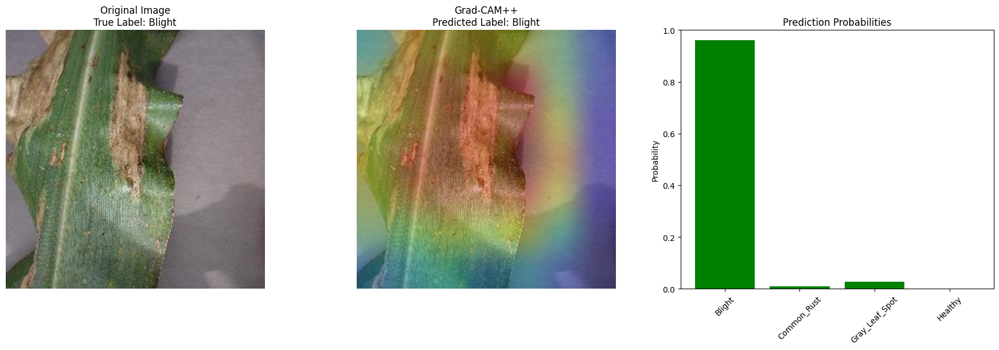

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


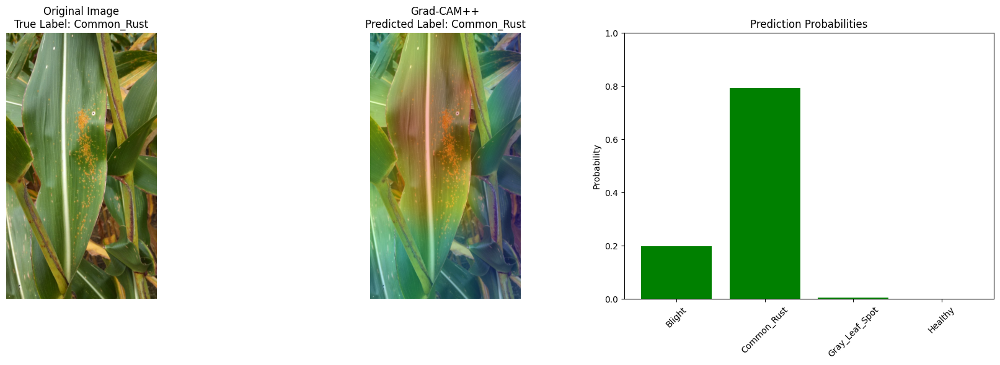

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


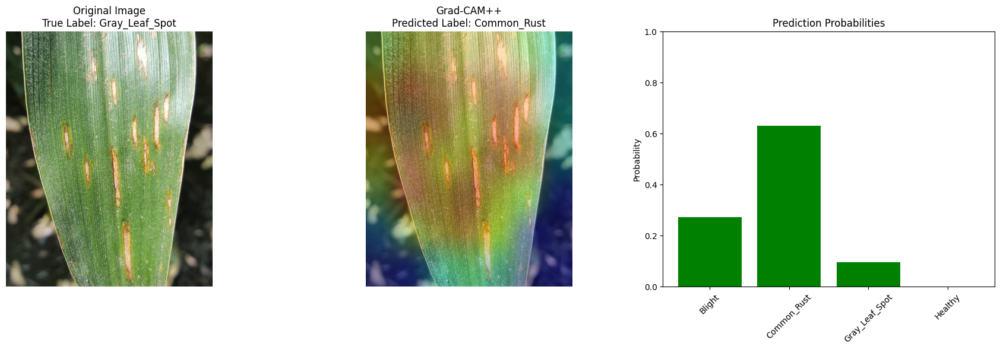

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


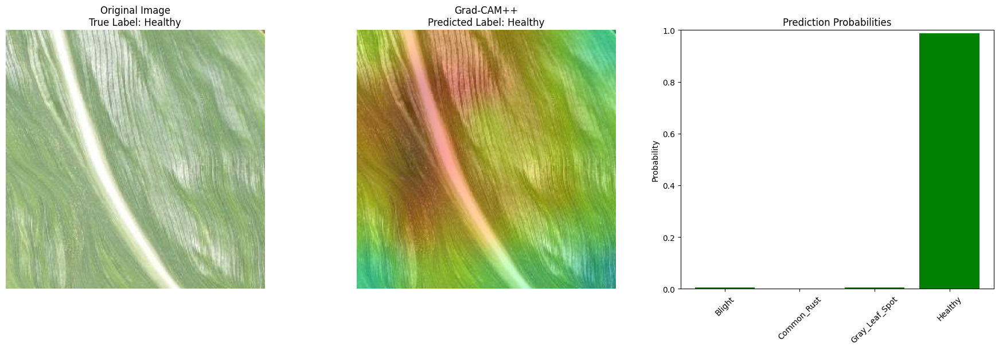

In [ ]:
import os
import random
from tensorflow.keras.preprocessing.image import load_img, img_to_array

def get_random_images(test_dir, class_names, img_size):
    """
    Randomly selects one image from each class directory in the test directory.

    Parameters:
        test_dir (str): Path to the test directory containing class folders.
        class_names (list): List of class folder names.
        img_size (int): Image size for resizing.

    Returns:
        dict: Dictionary with class names as keys and paths to random images as values.
    """
    random_images = {}
    for class_name in class_names:
        class_dir = os.path.join(test_dir, class_name)
        img_files = os.listdir(class_dir)
        random_img = random.choice(img_files)
        random_images[class_name] = os.path.join(class_dir, random_img)
    return random_images

def visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=224):
    """
    Visualizes Grad-CAM++ for randomly selected images from all test classes.

    Parameters:
        test_dir (str): Path to the test directory containing class folders.
        class_names (list): List of class folder names.
        model (tf.keras.Model): Trained model.
        last_conv_layer_name (str): Name of the last convolutional layer for Grad-CAM++.
        img_size (int): Image size for resizing.
    """
    # Get random images from each class
    random_images = get_random_images(test_dir, class_names, img_size)

    for true_label, img_path in random_images.items():
        # Load and preprocess the image
        img_array = get_img_array(img_path, size=img_size)

        # Predict probabilities and class
        predictions = model.predict(img_array)
        predicted_class_probs = predictions[0]
        predicted_class_index = np.argmax(predicted_class_probs)
        predicted_label = class_names[predicted_class_index]

        # Generate Grad-CAM++ heatmap
        heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

        # Plot the visualization
        plot_full_visualization(
            img_path,
            heatmap,
            predicted_class_probs,
            class_names,
            true_label,
            predicted_label
        )

# Define paths and parameters
test_dir = 'Leaf_Disease/test'  # Path to your test dataset directory
class_names = ['Blight', 'Common_Rust', 'Gray_Leaf_Spot', 'Healthy']  # Class folder names
last_conv_layer_name = 'Conv_1'  # Last convolutional layer name of MobileNetV2
img_size = 224

# Call the function to visualize
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


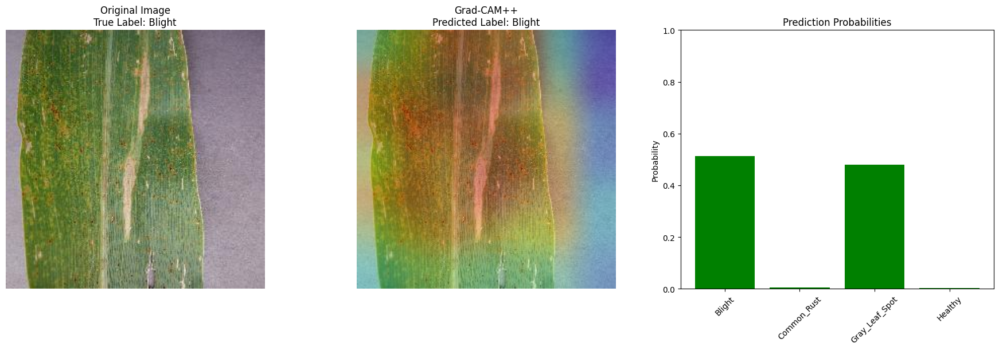

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


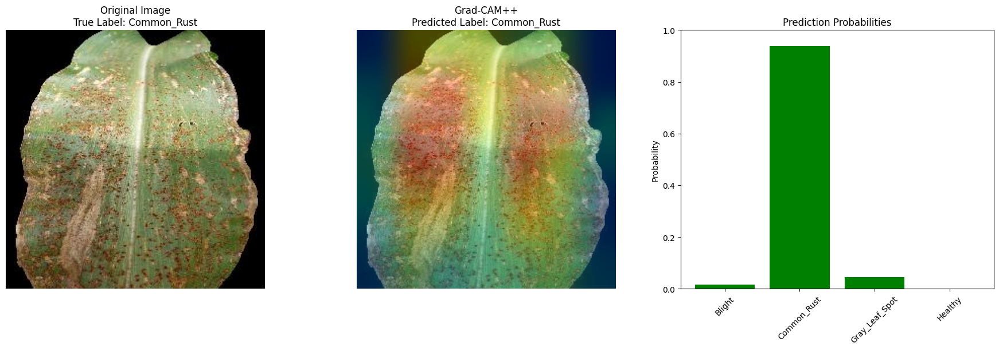

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


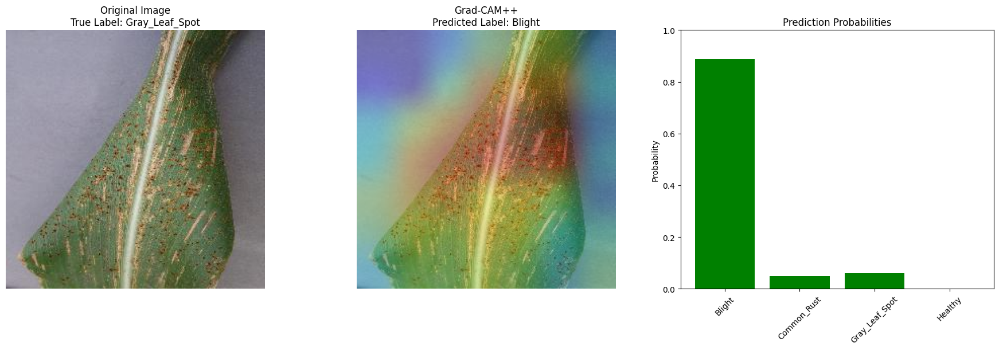

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


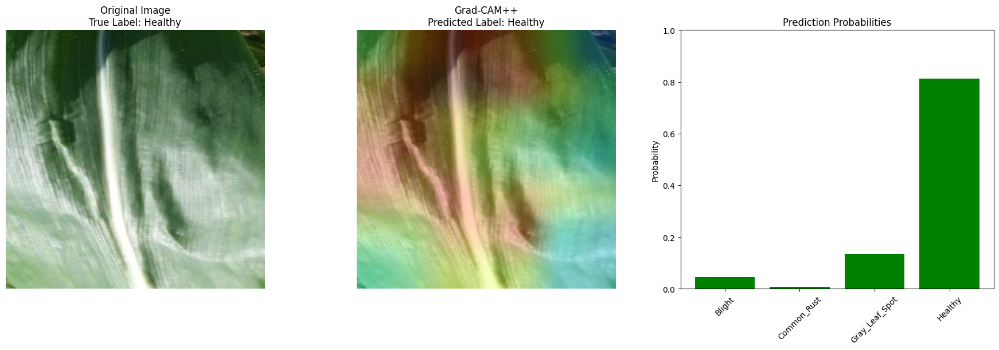

In [ ]:
# Call the function to visualize
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


In [ ]:
def plot_full_visualization(img_path, heatmap, probabilities, class_names, true_label, predicted_label, alpha=0.4):
    """
    Display the original image with the true label, Grad-CAM++ heatmap with the predicted label,
    and a bar plot for class probabilities. If prediction is incorrect, mark the predicted bar in red.

    Parameters:
        img_path (str): Path to the input image.
        heatmap (numpy array): Grad-CAM++ heatmap.
        probabilities (list or numpy array): Probabilities for all classes.
        class_names (list): Names of the classes.
        true_label (str): True label of the image.
        predicted_label (str): Predicted label of the image.
        alpha (float): Transparency for heatmap overlay.
    """
    # Load the original image
    img = tf.keras.preprocessing.image.load_img(img_path)
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    # Apply the heatmap to the image
    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img_array.shape[1], img_array.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img_array
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Create the plots
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))

    # Original image with true label
    ax[0].imshow(img)
    ax[0].axis('off')
    ax[0].set_title(f"Original Image\nTrue Label: {true_label}")

    # Grad-CAM++ heatmap with predicted label
    ax[1].imshow(superimposed_img)
    ax[1].axis('off')
    ax[1].set_title(f"Grad-CAM++\nPredicted Label: {predicted_label}")

    # Bar plot for probabilities
    bar_colors = ['green'] * len(class_names)  # Default color for all bars
    if true_label != predicted_label:
        predicted_index = class_names.index(predicted_label)
        bar_colors[predicted_index] = 'red'  # Mark the predicted class in red if incorrect

    ax[2].bar(range(len(probabilities)), probabilities, color=bar_colors)
    ax[2].set_xticks(range(len(class_names)))
    ax[2].set_xticklabels(class_names, rotation=45)
    ax[2].set_ylim(0, 1)
    ax[2].set_ylabel('Probability')
    ax[2].set_title('Prediction Probabilities')

    plt.tight_layout()
    plt.show()

# Function to visualize random images from the test set
def visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=224):
    """
    Visualizes Grad-CAM++ for randomly selected images from all test classes.

    Parameters:
        test_dir (str): Path to the test directory containing class folders.
        class_names (list): List of class folder names.
        model (tf.keras.Model): Trained model.
        last_conv_layer_name (str): Name of the last convolutional layer for Grad-CAM++.
        img_size (int): Image size for resizing.
    """
    # Get random images from each class
    random_images = get_random_images(test_dir, class_names, img_size)

    for true_label, img_path in random_images.items():
        # Load and preprocess the image
        img_array = get_img_array(img_path, size=img_size)

        # Predict probabilities and class
        predictions = model.predict(img_array)
        predicted_class_probs = predictions[0]
        predicted_class_index = np.argmax(predicted_class_probs)
        predicted_label = class_names[predicted_class_index]

        # Generate Grad-CAM++ heatmap
        heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

        # Plot the visualization
        plot_full_visualization(
            img_path,
            heatmap,
            predicted_class_probs,
            class_names,
            true_label,
            predicted_label
        )


In [ ]:
# Lime Implementation

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


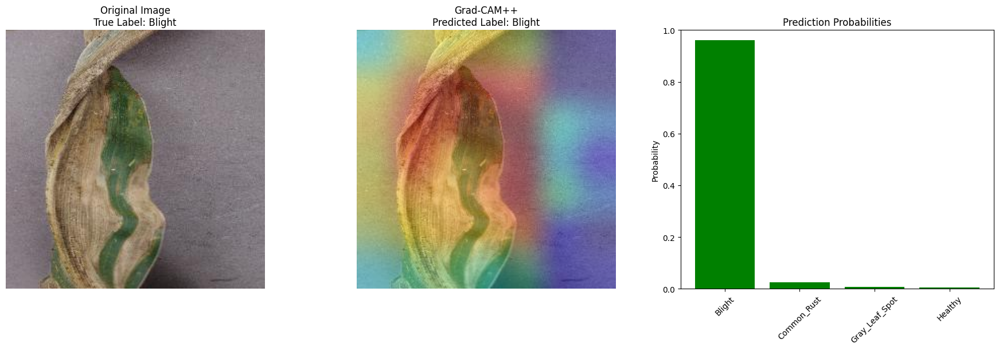

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


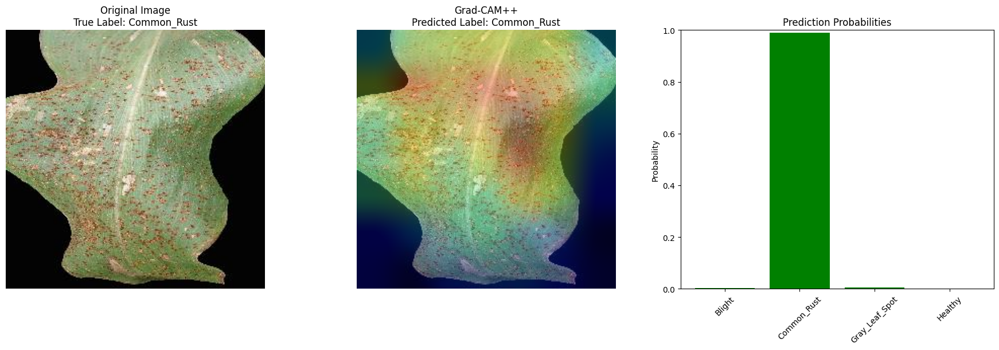

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


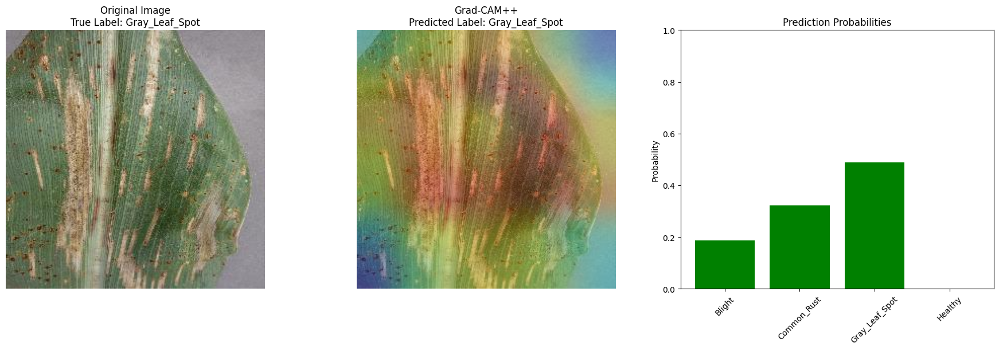

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


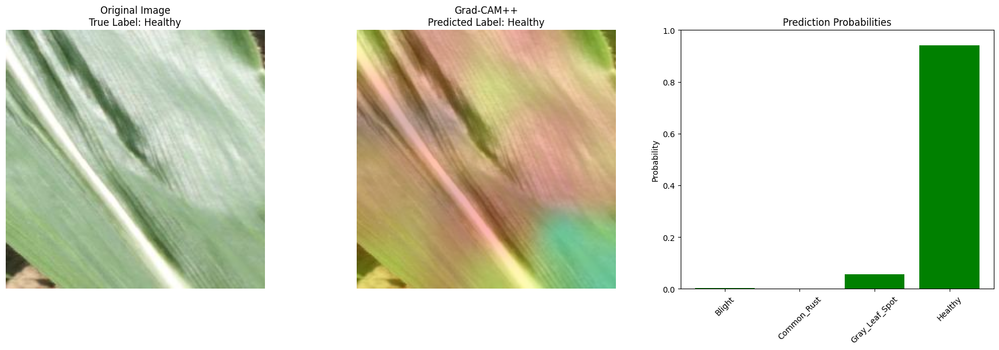

In [ ]:
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


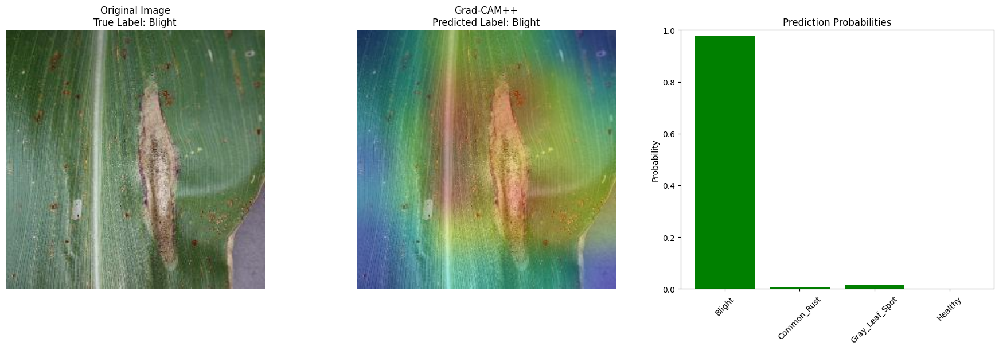

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


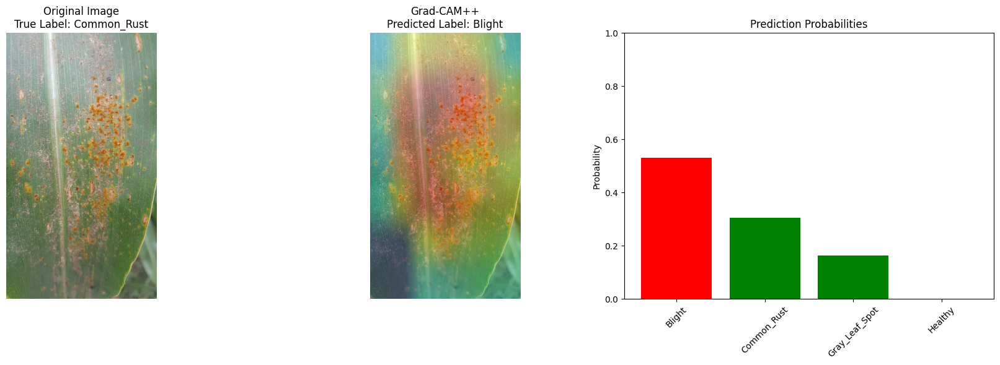

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


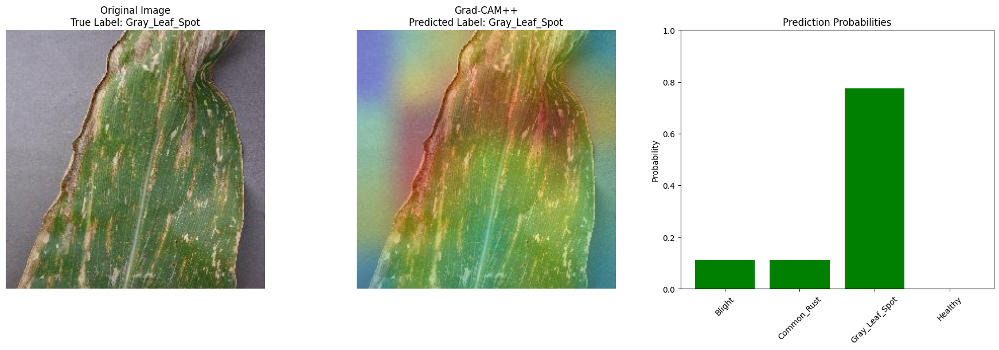

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


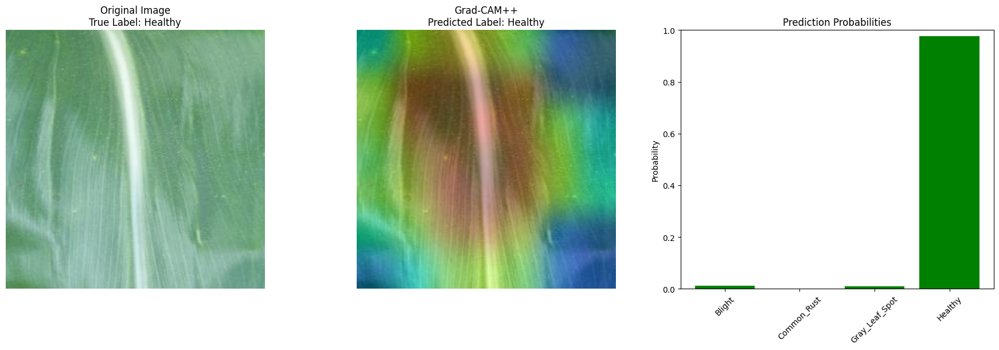

In [ ]:
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


In [ ]:
# Creating Lime

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from lime import lime_image
from skimage.segmentation import mark_boundaries
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as mobilenet_preprocess


In [ ]:

# Set your model
model = mobilenetv2_model  # Replace with your trained MobileNetV2 model


In [ ]:

# Define preprocessing transform for LIME
def get_preprocess_transform():
    return mobilenet_preprocess  # Use preprocessing for MobileNetV2

preprocess_transform = get_preprocess_transform()


In [ ]:

# Define batch prediction function for LIME
def batch_predict(images):
    """
    Applies preprocessing and makes predictions on a batch of images.
    Parameters:
        images (list or numpy array): Batch of images.
    Returns:
        numpy array: Predictions from the model.
    """
    # Preprocess and predict
    images = np.array([preprocess_transform(img) for img in images])
    predictions = model.predict(images)
    return predictions


In [ ]:

# Load and preprocess a sample image
def load_image(image_path, target_size=(224, 224)):
    """
    Loads and preprocesses an image for the model.
    Parameters:
        image_path (str): Path to the image.
        target_size (tuple): Target size for resizing.
    Returns:
        numpy array: Preprocessed image.
    """
    img = Image.open(image_path)
    # Convert to RGB if not already
    if img.mode != 'RGB':
        img = img.convert('RGB')
    # Resize to the input size expected by the model
    img = img.resize(target_size)
    return np.array(img)


In [ ]:

# Path to the image
image_path = 'splitted_data/test/Common_Rust/Corn_Common_Rust (31).jpg'
input_img = load_image(image_path)


In [ ]:

# Initialize LIME image explainer
explainer = lime_image.LimeImageExplainer(random_state=42)

# Get the explanation for the top classes
explanation = explainer.explain_instance(
    input_img,
    batch_predict,  # Function for predicting classes
    top_labels=5,
    hide_color=0,
    num_samples=1000  # Number of perturbed samples
)


  0%|                                                  | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  1%|▍                                        | 10/1000 [00:00<00:11, 85.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  2%|▉                                       | 23/1000 [00:00<00:08, 109.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  4%|█▍                                      | 35/1000 [00:00<00:08, 112.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  5%|█▉                                      | 47/1000 [00:00<00:08, 114.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  6%|██▎                                     | 59/1000 [00:00<00:08, 115.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  7%|██▉                                      | 71/1000 [00:00<00:10, 91.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  8%|███▎                                     | 82/1000 [00:00<00:09, 96.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  9%|███▊                                     | 93/1000 [00:00<00:10, 83.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 10%|████                                    | 103/1000 [00:01<00:10, 83.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 11%|████▌                                   | 113/1000 [00:01<00:10, 87.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 12%|████▉                                   | 123/1000 [00:01<00:09, 90.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 14%|█████▍                                  | 135/1000 [00:01<00:08, 98.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 15%|█████▋                                 | 146/1000 [00:01<00:08, 101.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 16%|██████                                 | 157/1000 [00:01<00:08, 103.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 17%|██████▌                                | 168/1000 [00:01<00:08, 102.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 18%|██████▉                                | 179/1000 [00:01<00:07, 103.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 19%|███████▌                                | 190/1000 [00:01<00:09, 85.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|████████                                | 203/1000 [00:02<00:08, 96.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 21%|████████▌                               | 214/1000 [00:02<00:07, 99.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 22%|████████▊                              | 225/1000 [00:02<00:07, 102.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 24%|█████████▏                             | 236/1000 [00:02<00:07, 103.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 25%|█████████▋                             | 247/1000 [00:02<00:07, 105.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 26%|██████████                             | 258/1000 [00:02<00:07, 104.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██████████▍                            | 269/1000 [00:02<00:06, 105.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 28%|███████████▏                            | 280/1000 [00:02<00:08, 86.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 29%|███████████▋                            | 293/1000 [00:02<00:07, 97.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 30%|███████████▉                           | 305/1000 [00:03<00:06, 102.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 32%|████████████▎                          | 316/1000 [00:03<00:06, 103.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 33%|████████████▊                          | 327/1000 [00:03<00:06, 102.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 34%|█████████████▏                         | 339/1000 [00:03<00:06, 107.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 35%|██████████████                          | 350/1000 [00:03<00:07, 88.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 36%|██████████████▌                         | 363/1000 [00:03<00:06, 98.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 38%|██████████████▋                        | 376/1000 [00:03<00:05, 106.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 39%|███████████████▏                       | 388/1000 [00:03<00:05, 110.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████████████████                        | 400/1000 [00:04<00:06, 92.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 41%|████████████████▍                       | 411/1000 [00:04<00:06, 96.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 42%|████████████████▌                      | 424/1000 [00:04<00:05, 104.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 44%|█████████████████                      | 437/1000 [00:04<00:05, 111.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 45%|██████████████████                      | 450/1000 [00:04<00:05, 95.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 46%|██████████████████                     | 464/1000 [00:04<00:05, 105.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 48%|██████████████████▌                    | 477/1000 [00:04<00:04, 111.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 49%|███████████████████                    | 489/1000 [00:04<00:04, 113.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|████████████████████                    | 501/1000 [00:05<00:05, 94.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 51%|████████████████████                   | 514/1000 [00:05<00:04, 103.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 53%|████████████████████▌                  | 528/1000 [00:05<00:04, 112.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 54%|█████████████████████▌                  | 540/1000 [00:05<00:04, 94.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 55%|█████████████████████▌                 | 552/1000 [00:05<00:04, 100.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 56%|█████████████████████▉                 | 563/1000 [00:05<00:04, 102.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|██████████████████████▍                | 574/1000 [00:05<00:04, 104.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 59%|██████████████████████▉                | 587/1000 [00:05<00:03, 111.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 60%|███████████████████████▎               | 599/1000 [00:05<00:03, 113.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 61%|████████████████████████▍               | 611/1000 [00:06<00:04, 94.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 62%|████████████████████████▎              | 623/1000 [00:06<00:03, 100.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 64%|████████████████████████▊              | 637/1000 [00:06<00:03, 110.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 65%|██████████████████████████              | 650/1000 [00:06<00:03, 95.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 66%|██████████████████████████▍             | 661/1000 [00:06<00:03, 98.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 68%|██████████████████████████▎            | 675/1000 [00:06<00:02, 108.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 69%|██████████████████████████▊            | 688/1000 [00:06<00:02, 114.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|████████████████████████████            | 700/1000 [00:06<00:03, 93.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 71%|████████████████████████████▍           | 711/1000 [00:07<00:02, 97.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 72%|████████████████████████████▉           | 722/1000 [00:07<00:02, 99.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|████████████████████████████▋          | 734/1000 [00:07<00:02, 105.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 74%|█████████████████████████████          | 745/1000 [00:07<00:02, 101.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 76%|█████████████████████████████▌         | 757/1000 [00:07<00:02, 106.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|██████████████████████████████▊         | 770/1000 [00:07<00:02, 92.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 78%|███████████████████████████████▎        | 782/1000 [00:07<00:02, 99.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|███████████████████████████████        | 795/1000 [00:07<00:01, 107.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 81%|███████████████████████████████▌       | 808/1000 [00:07<00:01, 113.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 82%|████████████████████████████████▊       | 820/1000 [00:08<00:01, 93.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 84%|████████████████████████████████▌      | 835/1000 [00:08<00:01, 107.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 85%|█████████████████████████████████      | 847/1000 [00:08<00:01, 110.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 86%|█████████████████████████████████▌     | 859/1000 [00:08<00:01, 112.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|██████████████████████████████████▊     | 871/1000 [00:08<00:01, 94.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 88%|██████████████████████████████████▌    | 885/1000 [00:08<00:01, 105.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|██████████████████████████████████▉    | 897/1000 [00:08<00:00, 108.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 91%|████████████████████████████████████▍   | 910/1000 [00:09<00:00, 93.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 92%|███████████████████████████████████▉   | 922/1000 [00:09<00:00, 100.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 93%|████████████████████████████████████▍  | 934/1000 [00:09<00:00, 104.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 95%|████████████████████████████████████▉  | 947/1000 [00:09<00:00, 111.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 96%|██████████████████████████████████████▍ | 960/1000 [00:09<00:00, 95.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 97%|█████████████████████████████████████▉ | 972/1000 [00:09<00:00, 101.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 99%|██████████████████████████████████████▍| 986/1000 [00:09<00:00, 110.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


100%|██████████████████████████████████████| 1000/1000 [00:09<00:00, 101.21it/s]


In [ ]:

# Get class names from your test data generator
class_names = ['Blight', 'Common_Rust', 'Gray Leaf Spot', 'Healthy']  # Replace with your actual class names

# Predict the probabilities for the top 5 classes
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]
top5_idx = probs.argsort()[-5:][::-1]

print("Top 5 predictions:")
for idx in top5_idx:
    print(f"Class {class_names[idx]}: {probs[idx]:.4f}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Top 5 predictions:
Class Common_Rust: 0.7993
Class Gray Leaf Spot: 0.1830
Class Blight: 0.0167
Class Healthy: 0.0010


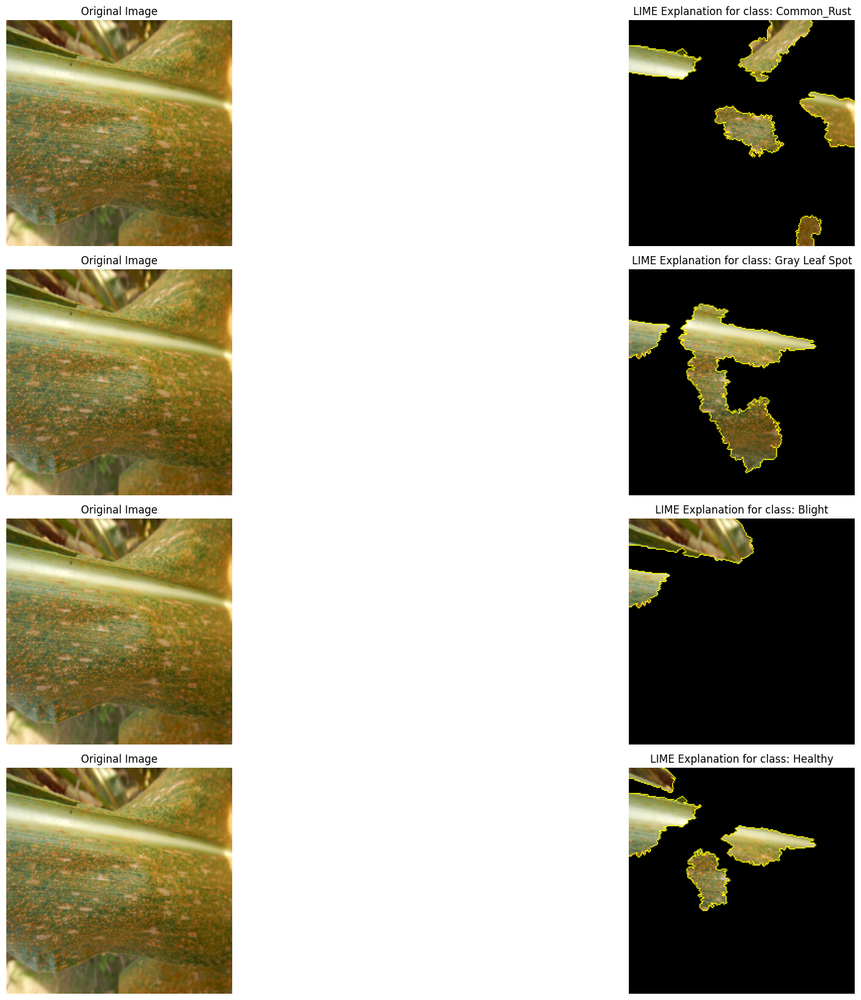

In [ ]:

# Visualize explanations for the top 5 predicted classes
plt.figure(figsize=(20, 4 * 5))
for idx, label in enumerate(explanation.top_labels):
    # Get the image and mask for the label
    temp, mask = explanation.get_image_and_mask(
        label, positive_only=True, num_features=5, hide_rest=True
    )

    img_boundary = mark_boundaries(temp / 255.0, mask)

    plt.subplot(5, 2, 2 * idx + 1)
    plt.imshow(input_img)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(5, 2, 2 * idx + 2)
    plt.imshow(img_boundary)
    class_name = class_names[label]  # Map label index to class name
    plt.title(f"LIME Explanation for class: {class_name}")
    plt.axis('off')

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


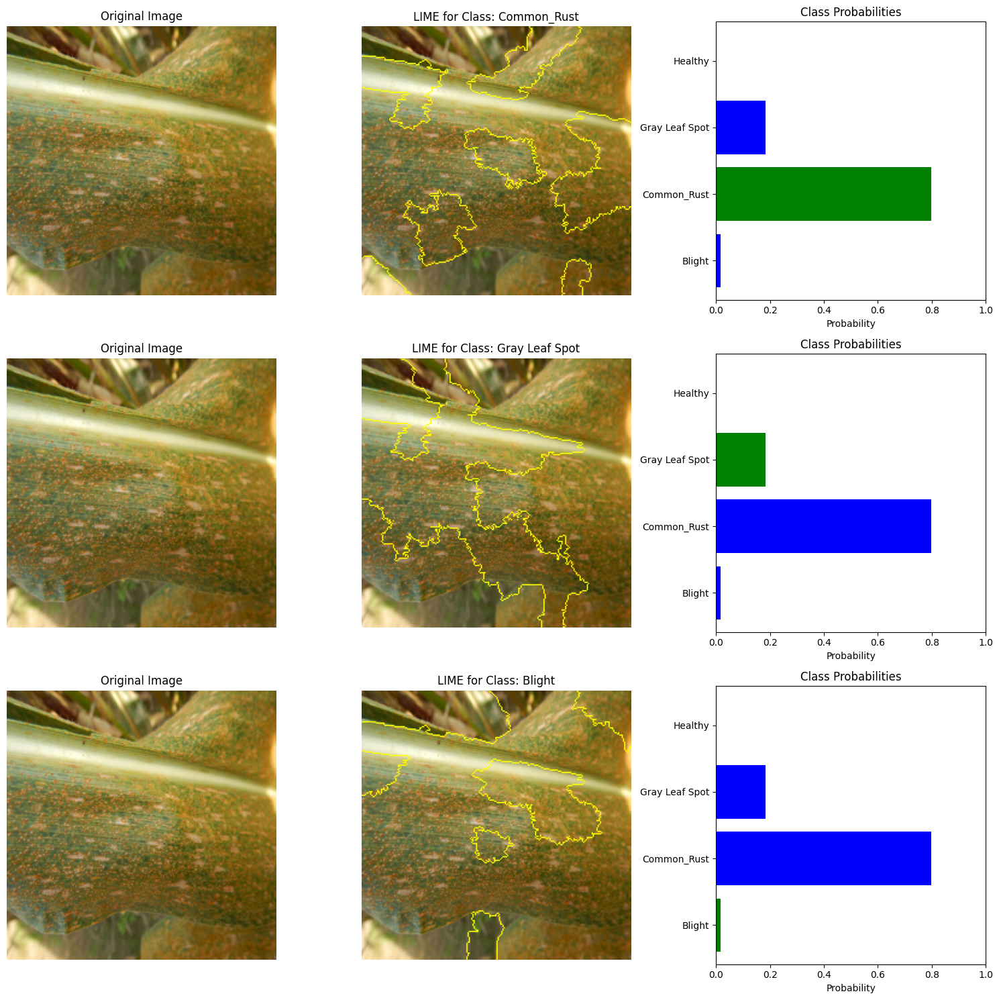

In [ ]:
def visualize_lime_explanation(input_img, explanation, class_names, probabilities, top_k=3):

    # Get the top-k classes for visualization
    top_labels = explanation.top_labels[:top_k]
    top_probs = probabilities[top_labels]

    fig, axes = plt.subplots(len(top_labels), 3, figsize=(15, 5 * len(top_labels)))

    if len(top_labels) == 1:
        axes = [axes]  # Ensure axes are iterable for a single label

    for idx, label in enumerate(top_labels):
        # Get the image and mask for the label
        temp, mask = explanation.get_image_and_mask(
            label, positive_only=True, num_features=10, hide_rest=False
        )
        img_boundary = mark_boundaries(temp / 255.0, mask)

        # Plot the original image
        axes[idx][0].imshow(input_img)
        axes[idx][0].set_title("Original Image")
        axes[idx][0].axis('off')

        # Plot the LIME explanation
        axes[idx][1].imshow(img_boundary)
        axes[idx][1].set_title(f"LIME for Class: {class_names[label]}")
        axes[idx][1].axis('off')

        # Plot the class probabilities
        axes[idx][2].barh(class_names, probabilities, color='blue')
        axes[idx][2].barh(class_names[label], probabilities[label], color='green')
        axes[idx][2].set_xlim(0, 1)
        axes[idx][2].set_title("Class Probabilities")
        axes[idx][2].set_xlabel("Probability")

    plt.tight_layout()
    plt.show()



# Predict the probabilities for the image
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]

# Visualize the LIME explanation
visualize_lime_explanation(input_img, explanation, class_names, probs, top_k=3)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


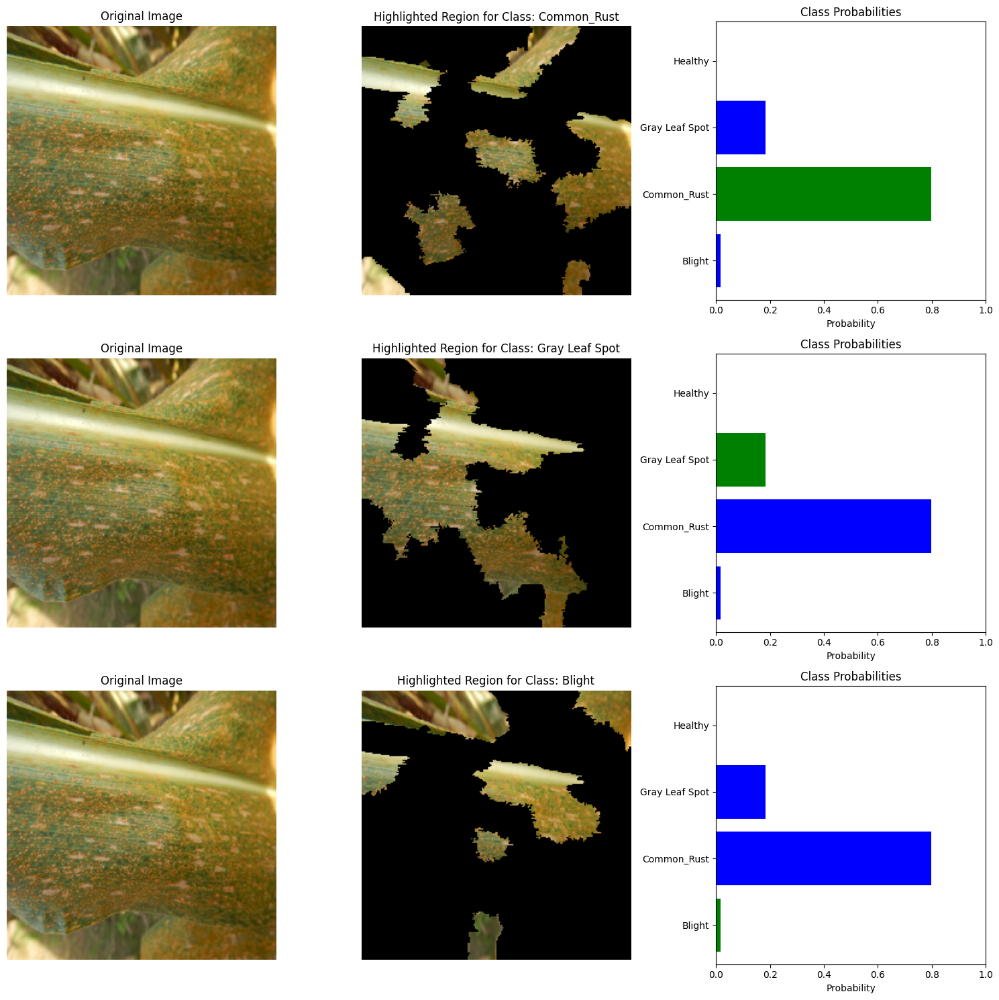

In [ ]:
def visualize_lime_explanation_highlighted(input_img, explanation, class_names, probabilities, top_k=3):
    """
    Visualize the LIME explanation with only the highlighted region visible (rest of the image blacked out),
    along with the class probability graph.

    Parameters:
        input_img (numpy array): The original input image (before preprocessing).
        explanation (lime_image.ImageExplanation): LIME explanation object.
        class_names (list): List of class names corresponding to model output.
        probabilities (list or numpy array): Probabilities for all classes.
        top_k (int): Number of top classes to display.
    """
    # Get the top-k classes for visualization
    top_labels = explanation.top_labels[:top_k]

    fig, axes = plt.subplots(len(top_labels), 3, figsize=(15, 5 * len(top_labels)))

    if len(top_labels) == 1:
        axes = [axes]  # Ensure axes are iterable for a single label

    for idx, label in enumerate(top_labels):
        # Get the image and mask for the label
        temp, mask = explanation.get_image_and_mask(
            label, positive_only=True, num_features=10, hide_rest=True
        )

        # Apply the mask to the input image (highlight only the important regions)
        highlighted_img = np.zeros_like(input_img)
        highlighted_img[mask == 1] = input_img[mask == 1]

        # Plot the original image
        axes[idx][0].imshow(input_img)
        axes[idx][0].set_title("Original Image")
        axes[idx][0].axis('off')

        # Plot the highlighted image with blacked-out regions
        axes[idx][1].imshow(highlighted_img)
        axes[idx][1].set_title(f"Highlighted Region for Class: {class_names[label]}")
        axes[idx][1].axis('off')

        # Plot the class probabilities
        axes[idx][2].barh(class_names, probabilities, color='blue')
        axes[idx][2].barh(class_names[label], probabilities[label], color='green')
        axes[idx][2].set_xlim(0, 1)
        axes[idx][2].set_title("Class Probabilities")
        axes[idx][2].set_xlabel("Probability")

    plt.tight_layout()
    plt.show()


# Predict the probabilities for the image
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]

# Visualize the LIME explanation with highlighted regions
visualize_lime_explanation_highlighted(input_img, explanation, class_names, probs, top_k=3)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


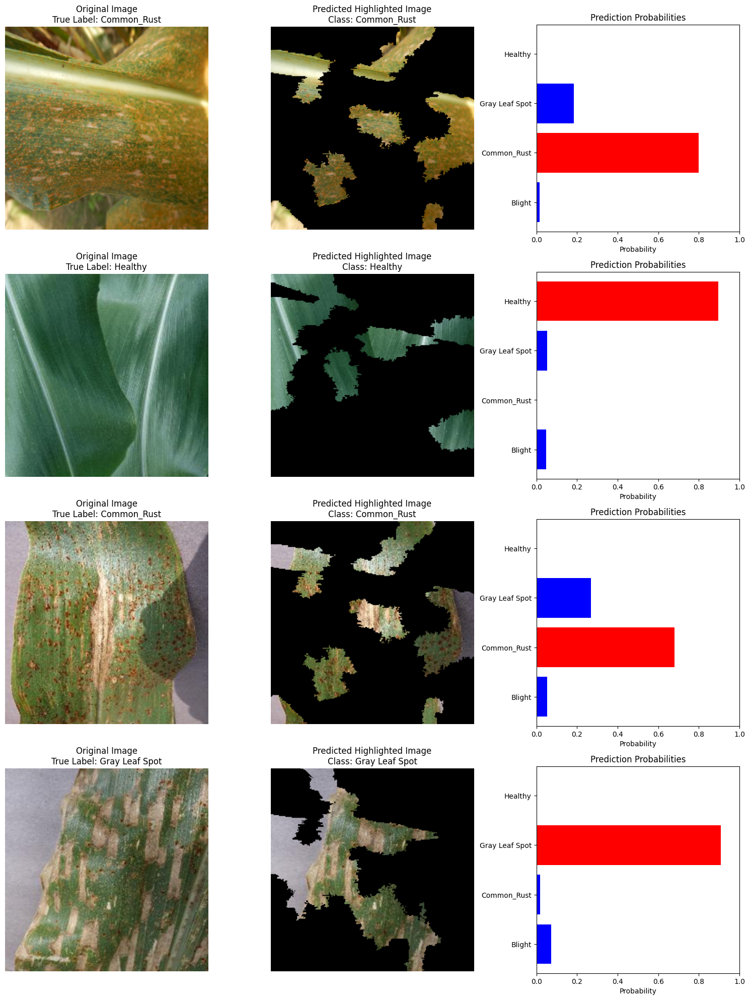

In [ ]:
def visualize_lime_for_multiple_images(image_paths, model, class_names, explainer, last_conv_layer_name):
    """
    Visualize LIME explanations for multiple images with original image, highlighted image, and probability graph.

    Parameters:
        image_paths (list): List of paths to the test images.
        model (tf.keras.Model): Trained model.
        class_names (list): List of class names corresponding to model output.
        explainer (lime_image.LimeImageExplainer): Initialized LIME explainer.
        last_conv_layer_name (str): Name of the last convolutional layer.
    """
    fig, axes = plt.subplots(len(image_paths), 3, figsize=(15, 5 * len(image_paths)))

    for i, image_path in enumerate(image_paths):
        # Load and preprocess the image
        input_img = load_image(image_path)
        img_array = np.expand_dims(input_img, axis=0)

        # Predict probabilities
        probs = batch_predict(img_array)[0]
        predicted_label = np.argmax(probs)
        predicted_class_name = class_names[predicted_label]


        temp, mask = explanation.get_image_and_mask(
            predicted_label, positive_only=True, num_features=10, hide_rest=False
        )

        # Highlighted image
        highlighted_img = np.zeros_like(input_img)
        highlighted_img[mask == 1] = input_img[mask == 1]

        # Plot the original image
        axes[i][0].imshow(input_img)
        axes[i][0].set_title(f"Original Image\nTrue Label: {class_names[predicted_label]}")
        axes[i][0].axis('off')

        # Plot the highlighted image
        axes[i][1].imshow(highlighted_img)
        axes[i][1].set_title(f"Predicted Highlighted Image\nClass: {predicted_class_name}")
        axes[i][1].axis('off')

        # Plot the probability graph
        axes[i][2].barh(class_names, probs, color='blue')
        axes[i][2].barh(class_names[predicted_label], probs[predicted_label], color='red')
        axes[i][2].set_xlim(0, 1)
        axes[i][2].set_title("Prediction Probabilities")
        axes[i][2].set_xlabel("Probability")

    plt.tight_layout()
    plt.show()

# Example Usage
image_paths = [
    "splitted_data/test/Common_Rust/Corn_Common_Rust (31).jpg",
    "dataset/Healthy/Corn_Health (9).jpg",
    "dataset/Blight/Corn_Blight (1000).jpg",
    "dataset/Gray_Leaf_Spot/Corn_Gray_Spot (161).JPG"
]


# Visualize LIME for the images
visualize_lime_for_multiple_images(image_paths, model, class_names, explainer, last_conv_layer_name="Conv_1")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


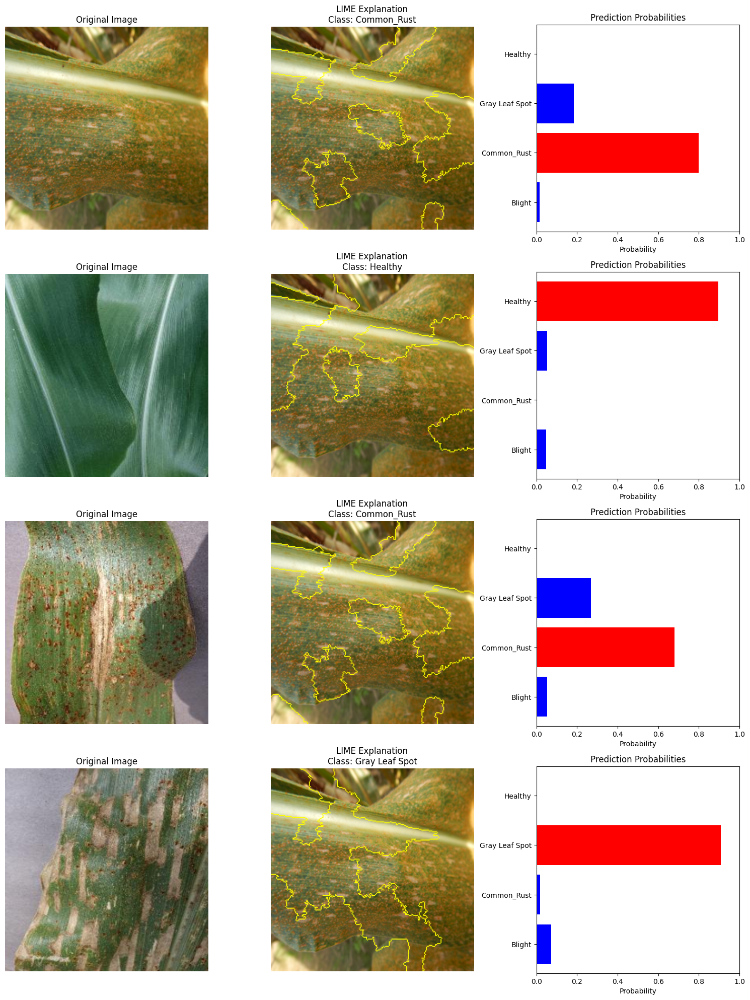

In [ ]:
def visualize_lime_without_blackout(image_paths, model, class_names, explainer):
    """
    Visualize LIME explanations for multiple images without blackout (keep the original image with boundaries).

    Parameters:
        image_paths (list): List of paths to the test images.
        model (tf.keras.Model): Trained model.
        class_names (list): List of class names corresponding to model output.
        explainer (lime_image.LimeImageExplainer): Initialized LIME explainer.
    """
    fig, axes = plt.subplots(len(image_paths), 3, figsize=(15, 5 * len(image_paths)))

    for i, image_path in enumerate(image_paths):
        # Load and preprocess the image
        input_img = load_image(image_path)
        img_array = np.expand_dims(input_img, axis=0)

        # Predict probabilities
        probs = batch_predict(img_array)[0]
        predicted_label = np.argmax(probs)
        predicted_class_name = class_names[predicted_label]


        temp, mask = explanation.get_image_and_mask(
            predicted_label, positive_only=True, num_features=10, hide_rest=False
        )

        # Create LIME explanation image with boundaries
        lime_image_with_boundaries = mark_boundaries(temp / 255.0, mask)

        # Plot the original image
        axes[i][0].imshow(input_img)
        axes[i][0].set_title("Original Image")
        axes[i][0].axis('off')

        # Plot the LIME explanation image with boundaries
        axes[i][1].imshow(lime_image_with_boundaries)
        axes[i][1].set_title(f"LIME Explanation\nClass: {predicted_class_name}")
        axes[i][1].axis('off')

        # Plot the probability graph
        axes[i][2].barh(class_names, probs, color='blue')
        axes[i][2].barh(class_names[predicted_label], probs[predicted_label], color='red')
        axes[i][2].set_xlim(0, 1)
        axes[i][2].set_title("Prediction Probabilities")
        axes[i][2].set_xlabel("Probability")

    plt.tight_layout()
    plt.show()

# Example Usage
image_paths = [
    "splitted_data/test/Common_Rust/Corn_Common_Rust (31).jpg",
    "dataset/Healthy/Corn_Health (9).jpg",
    "dataset/Blight/Corn_Blight (1000).jpg",
    "dataset/Gray_Leaf_Spot/Corn_Gray_Spot (161).JPG"
]  # Replace with your image paths



# Visualize LIME for the images
visualize_lime_without_blackout(image_paths, model, class_names, explainer)
